In [11]:
import grass.script as gs
import os
import numpy as np
import grass.script as gs
from netCDF4 import Dataset
import rasterio
from rasterio.transform import from_origin
import tempfile
import os
import grass.script as gs
import grass.jupyter as gj
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch

import os
import grass.script as gs
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import Patch
import numpy as np
import tempfile
from math import ceil
import grass.script as gs
import matplotlib.pyplot as plt
import numpy as np
import tempfile
import os
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch
import grass.script as gs
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import os
import numpy as np
from io import StringIO
import tempfile

import plotly.graph_objects as go
import pandas as pd
from datetime import datetime
from tqdm import tqdm
import seaborn as sns
from matplotlib.ticker import FixedLocator
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.ndimage import gaussian_filter1d

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import Video
import pandas as pd
import matplotlib.ticker as ticker
import subprocess

import grass.script as gs
import matplotlib.pyplot as plt
import numpy as np
from grass.pygrass.raster import RasterRow




### 🛰️ Land Cover Transition Analysis Using GRASS GIS and Python

This notebook performs a detailed land cover change analysis using GRASS GIS raster data (`GLC_FCS30_YYYY`). It processes consecutive year pairs to generate transition maps, computes transition statistics, filters by valid classes and area thresholds, and exports results as CSV and PNG files. The script also visualizes major changes over time and provides summary metrics such as total changed area, most active transitions, and class stability.





===================== GRASS Land Cover Transition Analysis =====================
Start time: 2025-05-13 21:16:19

Available years: [1985, 1990, 1995, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]
Total years: 26

Processing 1985→1990
 - Overlapping area: 11710647.5 km²
 - Created transition map: trans_map_1985_1990
 - Raw stats saved to trans_stats_1985_1990.txt
 - Found 81 total transitions
 - 81 transitions meet area threshold (≥0 km²)

Processing 1990→1995
 - Overlapping area: 11710647.5 km²
 - Created transition map: trans_map_1990_1995
 - Raw stats saved to trans_stats_1990_1995.txt
 - Found 82 total transitions
 - 82 transitions meet area threshold (≥0 km²)

Processing 1995→2000
 - Overlapping area: 11710647.5 km²
 - Created transition map: trans_map_1995_2000
 - Raw stats saved to trans_stats_1995_2000.txt
 - Found 91 total transitions
 - 91 transitions meet area threshold (≥0 km²)

Proc

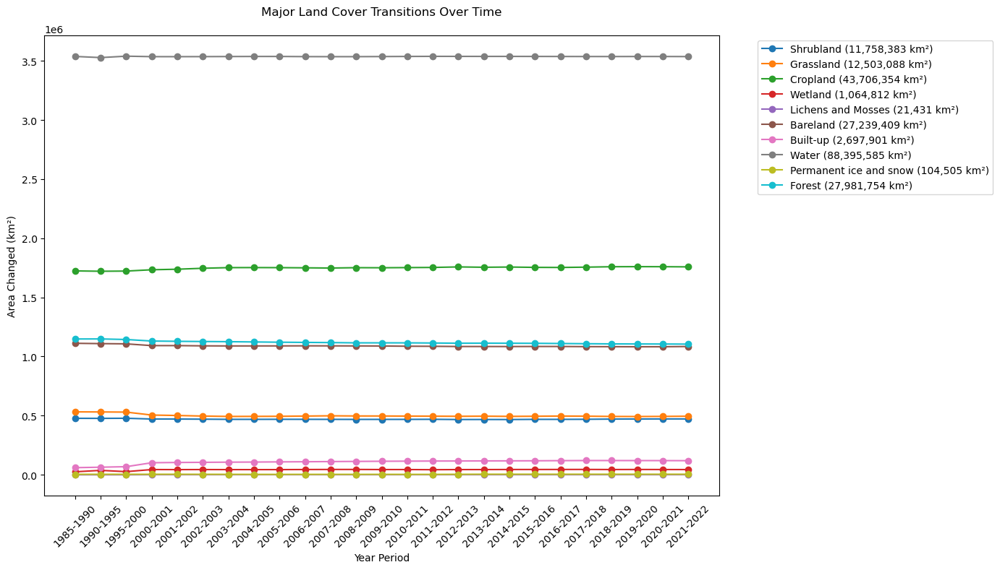

In [3]:
import grass.script as gs
import pandas as pd
import matplotlib.pyplot as plt
import os
from datetime import datetime

# Suppress system messages
os.environ['MallocStackLogging'] = '0'
os.environ['GRASS_VERBOSE'] = '0'

# Configuration
CLASS_LABELS = {
    5: "Shrubland",
    7: "Grassland",
    8: "Cropland",
    9: "Wetland",
    11: "Lichens and Mosses",
    12: "Bareland",
    13: "Built-up",
    15: "Water",
    16: "Permanent ice and snow",
    20: "Forest"
}
VALID_CLASSES = list(CLASS_LABELS.keys())
MIN_AREA_KM2 = 0  # Start with 0 to detect all transitions, can increase later
RESOLUTION_M2 = 900  # 30m x 30m = 900m²

def get_transitions(year1, year2):
    """Process transition between two years with enhanced quality control"""
    map1 = f"GLC_FCS30_{year1}@PERMANENT"
    map2 = f"GLC_FCS30_{year2}@PERMANENT"
    trans_map_name = f"trans_map_{year1}_{year2}"
    
    print(f"\nProcessing {year1}→{year2}")
    
    try:
        # Cleanup previous runs
        temp_maps = ['temp_clean1', 'temp_clean2', 'valid_mask', trans_map_name]
        for m in temp_maps:
            if m in gs.list_strings(type='raster'):
                gs.run_command('g.remove', type='raster', name=m, flags='f', quiet=True)
        
        # Set processing region
        gs.run_command('g.region', raster=map1)
        
        # Step 1: Create valid data mask - FIXED SYNTAX
        gs.mapcalc(
            f"valid_mask = if(!isnull({map1}) && !isnull({map2}), 1, null())",
            overwrite=True
        )
        
        # Check overlap area
        overlap_stats = gs.parse_command('r.univar', map='valid_mask', flags='g')
        overlap_area = float(overlap_stats['n']) * RESOLUTION_M2 / 1e6
        print(f" - Overlapping area: {overlap_area:.1f} km²")
        
        if overlap_area < 1.0:
            print(" - Warning: Minimal overlap between input rasters")
            return None
        
        # Step 2: Create transition map
        gs.mapcalc(
            f"{trans_map_name} = if(valid_mask, {map1}*100 + {map2}, null())",
            overwrite=True
        )
        print(f" - Created transition map: {trans_map_name}")
        
      
        
        # Get raw transition statistics
        stats = gs.read_command(
            'r.stats',
            flags='cn',
            input=trans_map_name,
            sep=':',
            quiet=True
        ).strip()
        
        if not stats:
            print(" - No transition data found")
            return None
            
        # Save raw stats for debugging
        with open(f"trans_stats_{year1}_{year2}.txt", 'w') as f:
            f.write(stats)
        print(f" - Raw stats saved to trans_stats_{year1}_{year2}.txt")
        
        # Process statistics
        data = []
        for line in stats.splitlines():
            try:
                combined_class, count = line.split(':')
                from_class = int(combined_class) // 100
                to_class = int(combined_class) % 100
                count = int(count)
                area_km2 = count * RESOLUTION_M2 / 1e6
                
                if (count > 0 and 
                    from_class in VALID_CLASSES and 
                    to_class in VALID_CLASSES):
                    data.append({
                        'From': from_class,
                        'To': to_class,
                        'Count': count,
                        'Area_km2': area_km2,
                        'From_Label': CLASS_LABELS[from_class],
                        'To_Label': CLASS_LABELS[to_class],
                        'Period': f"{year1}-{year2}"
                    })
            except (ValueError, KeyError) as e:
                continue
                
        if not data:
            print(" - No valid class transitions found")
            return None
            
        df = pd.DataFrame(data)
        
        # Apply area threshold
        filtered_df = df[df['Area_km2'] >= MIN_AREA_KM2]
        print(f" - Found {len(df)} total transitions")
        print(f" - {len(filtered_df)} transitions meet area threshold (≥{MIN_AREA_KM2} km²)")
        
        return filtered_df
        
    except Exception as e:
        print(f"Error processing {year1}→{year2}: {str(e)}")
        return None
    finally:
        # Cleanup temporary maps
        for m in temp_maps:
            if m in gs.list_strings(type='raster'):
                gs.run_command('g.remove', type='raster', name=m, flags='f', quiet=True)

def analyze_results(df):
    """Generate comprehensive analysis of results"""
    print("\n=== Transition Analysis ===")
    
    # Basic statistics
    total_area = df['Area_km2'].sum()
    period_count = len(df['Period'].unique())
    print(f"Total periods analyzed: {period_count}")
    print(f"Total changed area: {total_area:,.1f} km²")
    print(f"Average change per period: {total_area/period_count:,.1f} km²")
    
    # Top transitions
    print("\nTop 10 Transitions by Area:")
    top_trans = df.groupby(['From_Label', 'To_Label'])['Area_km2'].sum().nlargest(10)
    print(top_trans.to_string())
    
    # Class stability analysis
    print("\nClass Stability (same-class transitions):")
    stability = df[df['From'] == df['To']].groupby('From_Label')['Area_km2'].sum()
    print(stability.sort_values(ascending=False).to_string())
    
    # Periods with most change
    print("\nMost Active Periods:")
    period_change = df.groupby('Period')['Area_km2'].sum().nlargest(5)
    print(period_change.to_string())

def main():
    print(f"\n{' GRASS Land Cover Transition Analysis ':=^80}")
    print(f"Start time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}\n")
    
    # Get available years
    years = sorted(int(r.split('_')[-1].split('@')[0]) 
                  for r in gs.list_strings(type='raster') 
                  if r.startswith('GLC_FCS30_') and '@PERMANENT' in r)
    
    print(f"Available years: {years}\nTotal years: {len(years)}")
    
    # Process all consecutive year pairs
    results = []
    for i in range(len(years)-1):
        df = get_transitions(years[i], years[i+1])
        if df is not None:
            results.append(df)
    
    if not results:
        print("\nNo valid transitions processed! Check diagnostic files.")
        return
    
    # Combine results
    final_df = pd.concat(results)
    
    # Save outputs with timestamp
    timestamp = datetime.now().strftime("%Y%m%d_%H%M")
    output_files = {
        'detailed': f"landcover_1transitions_detailed_{timestamp}.csv",
        'simplified': f"landcover_1transitions_simplified_{timestamp}.csv",
        'top_transitions': f"top_1transitions_{timestamp}.csv"
    }
    
    final_df.to_csv(output_files['detailed'], index=False)
    final_df[['Period','From','From_Label','To','To_Label','Area_km2']].to_csv(
        output_files['simplified'], index=False)
    final_df.groupby(['From_Label','To_Label'])['Area_km2'].sum().nlargest(50).to_csv(
        output_files['top_transitions'])
    
    # Generate plots
    if not final_df.empty:
        plt.figure(figsize=(14, 8))
        
        # Plot major transitions (>1000 km² total change)
        for class_code in sorted(final_df['From'].unique()):
            class_data = final_df[final_df['From'] == class_code]
            total_change = class_data['Area_km2'].sum()
            if total_change > 1000:
                plt.plot(class_data['Period'].unique(),
                        [class_data[class_data['Period'] == p]['Area_km2'].sum() 
                         for p in class_data['Period'].unique()],
                        marker='o', 
                        label=f"{CLASS_LABELS[class_code]} ({total_change:,.0f} km²)")
        
        plt.title('Major Land Cover Transitions Over Time', pad=20)
        plt.xlabel('Year Period')
        plt.ylabel('Area Changed (km²)')
        plt.xticks(rotation=45)
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        plot_file = f"transitions_plot_{timestamp}.png"
        plt.savefig(plot_file, dpi=300, bbox_inches='tight')
        print(f"\nSaved plot: {plot_file}")
    
    # Generate report
    analyze_results(final_df)
    
    # List output files
    print(f"\n{' Output Files ':=^80}")
    for name, path in output_files.items():
        if os.path.exists(path):
            print(f"- {path} ({os.path.getsize(path)/1024:,.1f} KB)")
    
    # List transition maps in GRASS
    trans_maps = sorted(m for m in gs.list_strings(type='raster') 
                      if m.startswith('trans_map_'))
    print(f"\nSaved transition maps in GRASS ({len(trans_maps)} total):")
    for m in trans_maps[:5]:  # Show first 5 as example
        print(f"- {m}")
    if len(trans_maps) > 5:
        print(f"- ... and {len(trans_maps)-5} more")
    
    print(f"\n{' Analysis Complete ':=^80}")
    print(f"End time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")

if __name__ == "__main__":
    main()




    



### 📊 Load and Explore Land Cover Transition Data

This section imports and displays a detailed dataset of land cover transitions across multiple time periods. The dataset includes information such as transition counts, corresponding area in square kilometers, land cover types (e.g., Forest, Grassland, Cropland), and the period of transition. Summary statistics provide insights into the distribution of transition magnitudes, while the first few rows offer a snapshot of typical changes—such as conversions from Shrubland to Cropland or Bareland during 1985–1990.





In [6]:
import pandas as pd
import pandas as pd

# Load the CSV file
file_path = '/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv'
full_df = pd.read_csv(file_path)
# Display the full DataFrame
display(full_df)

# Show basic statistics
print("\nBasic statistics:")
print(full_df.describe())

# Show the first few rows
print("\nFirst 5 transitions:")
print(full_df.head())




,From,To,Count,Area_km2,From_Label,To_Label,Period
0,5,5,504899758,4.544098e+05,Shrubland,Shrubland,1985-1990
1,5,7,3252643,2.927379e+03,Shrubland,Grassland,1985-1990
2,5,8,12548159,1.129334e+04,Shrubland,Cropland,1985-1990
3,5,9,644007,5.796063e+02,Shrubland,Wetland,1985-1990
4,5,12,612650,5.513850e+02,Shrubland,Bareland,1985-1990
...,...,...,...,...,...,...,...
2446,20,12,30556,2.750040e+01,Forest,Bareland,2021-2022
2447,20,13,450281,4.052529e+02,Forest,Built-up,2021-2022
2448,20,15,52852,4.756680e+01,Forest,Water,2021-2022
2449,20,16,5077,4.569300e+00,Forest,Permanent ice and snow,2021-2022



Basic statistics:
              From           To         Count      Area_km2
count  2451.000000  2451.000000  2.451000e+03  2.451000e+03
mean     11.601795    11.604651  9.768041e+07  8.791237e+04
std       4.363548     4.356085  4.699690e+08  4.229721e+05
min       5.000000     5.000000  1.000000e+00  9.000000e-04
25%       8.000000     8.000000  1.484700e+04  1.336230e+01
50%      12.000000    12.000000  1.883770e+05  1.695393e+02
75%      15.000000    15.000000  1.258918e+06  1.133026e+03
max      20.000000    20.000000  3.928365e+09  3.535529e+06

First 5 transitions:
   From  To      Count     Area_km2 From_Label   To_Label     Period
0     5   5  504899758  454409.7822  Shrubland  Shrubland  1985-1990
1     5   7    3252643    2927.3787  Shrubland  Grassland  1985-1990
2     5   8   12548159   11293.3431  Shrubland   Cropland  1985-1990
3     5   9     644007     579.6063  Shrubland    Wetland  1985-1990
4     5  12     612650     551.3850  Shrubland   Bareland  1985-1990




### 🔄 Summary of Transition Magnitudes

This section summarizes the magnitude of land cover changes over time. First, it calculates the **total area changed per transition period**, revealing consistent annual changes of approximately **8.62 million km²** from 1985 to 2022. This consistency reflects that the **entire study region was analyzed uniformly across all years**.

Next, it identifies the **top 10 most common land cover transitions by total area**. The largest transitions are actually cases of *no change*, meaning the land cover class remained stable over time. These include:

* **Other to Other**: 88.3 million km²
* **Cropland to Cropland**: 42.9 million km²
* **Wetland to Wetland**: 27.6 million km²
* **Shrubland to Shrubland**: 27.1 million km²
* **Built-up to Built-up**: 12.1 million km²
* **Forest to Forest**: 11.4 million km²
* **Snow/Ice to Snow/Ice**: 2.53 million km²
* **Grassland to Grassland**: 0.95 million km²

Some smaller but notable transitions indicate actual land cover change:

* **Built-up to Cropland**: 239,605 km²
* **Cropland to Built-up**: 219,642 km²

These highlight dynamic exchanges particularly between urban and agricultural landscapes, while many other regions remain relatively stable.




In [7]:
# Total area changed per period
period_totals = full_df.groupby('Period')['Area_km2'].sum().reset_index()
print("\nTotal area changed per period:")
display(period_totals)

# Most common transitions
top_transitions = full_df.groupby(['From', 'To'])['Area_km2'].sum().sort_values(ascending=False)
print("\nTop 10 transitions by area:")
display(top_transitions.head(10))





Total area changed per period:


,Period,Area_km2
0,1985-1990,8.618962e+06
1,1990-1995,8.618962e+06
2,1995-2000,8.618926e+06
3,2000-2001,8.618926e+06
4,2001-2002,8.618926e+06
5,2002-2003,8.618926e+06
6,2003-2004,8.618926e+06
7,2004-2005,8.618926e+06
8,2005-2006,8.618926e+06
9,2006-2007,8.618926e+06



Top 10 transitions by area:


From  To
15    15    8.834017e+07
8     8     4.294144e+07
20    20    2.760577e+07
12    12    2.712514e+07
7     7     1.213583e+07
5     5     1.140066e+07
13    13    2.530476e+06
9     9     9.462416e+05
7     8     2.396045e+05
8     7     2.196420e+05
Name: Area_km2, dtype: float64


### 🌲 Forest Transitions Summary

This analysis isolates land cover transitions **from Forest (class 20)** across all time periods. It reveals how forested areas changed into other land cover types or remained stable.

#### 🔁 Key Transitions From Forest

A total of 248 distinct transitions were recorded from forests. The **dominant transition** is forest persisting as forest, with **over 1.1 million km² retained** each year. This indicates strong stability in many forested regions.

However, notable losses were also observed:

* **To Cropland (class 8)**: The most significant forest loss, with over **13,800 km²** converted in 1985–1990 and similar patterns in subsequent years.
* **To Shrubland (class 5)** and **Grassland (class 7)**: Thousands of square kilometers transitioned in almost every period.
* **To Built-up (class 13)**: Urban expansion steadily increased, with nearly **405 km²** of forest converted in 2021–2022.
* Smaller but persistent changes also occurred to **Wetland, Bareland**, and even **Permanent Ice/Snow**, indicating possible environmental degradation or classification shifts.

#### 📉 Forest Loss and Gain Over Time

* Forest cover declined most rapidly in the **early years (1985–2000)**, particularly due to cropland expansion.
* From **2000 onwards**, the rate of forest loss to cropland remained high but relatively stable.
* Interestingly, in the **final recorded year (2021–2022)**, forest loss to all classes dropped significantly—possibly due to slowing deforestation or changes in land management practices.






In [8]:
# Focus on a specific class (e.g., class 20 - Forest)
forest_transitions = full_df[full_df['From'] == 20]
print("\nAll transitions from Forest (class 20):")
display(forest_transitions)

# Forest gain/loss over time
forest_net_change = forest_transitions.groupby(['Period', 'To'])['Area_km2'].sum().unstack()
print("\nForest transitions over time:")
display(forest_net_change)

# Class labels
class_labels = {
    5: 'Shrubland',
    7: 'Grassland',
    8: 'Cropland',
    9: 'Wetland',
    11: 'Lichens and mosses',
    12: 'Bareland',
    13: 'Built-up',
    15: 'Water',
    16: 'Permanent ice and Snow',
    20: 'Forest',
    255: 'No data'
}




All transitions from Forest (class 20):


,From,To,Count,Area_km2,From_Label,To_Label,Period
72,20,5,7458007,6.712206e+03,Forest,Shrubland,1985-1990
73,20,7,3310172,2.979155e+03,Forest,Grassland,1985-1990
74,20,8,15358671,1.382280e+04,Forest,Cropland,1985-1990
75,20,9,607757,5.469813e+02,Forest,Wetland,1985-1990
76,20,12,8373,7.535700e+00,Forest,Bareland,1985-1990
...,...,...,...,...,...,...,...
2446,20,12,30556,2.750040e+01,Forest,Bareland,2021-2022
2447,20,13,450281,4.052529e+02,Forest,Built-up,2021-2022
2448,20,15,52852,4.756680e+01,Forest,Water,2021-2022
2449,20,16,5077,4.569300e+00,Forest,Permanent ice and snow,2021-2022



Forest transitions over time:


To,5,7,8,9,11,12,13,15,16,20
Period,,,,,,,,,,
1985-1990,6712.2063,2979.1548,13822.8039,546.9813,NaN,7.5357,206.9307,103.4721,22.5162,1.123651e+06
1990-1995,6397.5384,2264.7978,12621.6360,488.2014,NaN,8.5968,195.2829,250.8183,6.0327,1.126291e+06
1995-2000,17021.5065,4466.8998,43011.9954,552.0060,25.5537,237.0906,2349.0054,250.6473,29.3031,1.075737e+06
2000-2001,3018.7422,827.7192,7667.6013,396.7155,12.4893,55.6569,603.8559,36.8532,17.0172,1.118085e+06
2001-2002,3034.8702,989.5293,6916.3875,423.4689,9.1008,63.2016,568.4346,48.3345,1.8954,1.116259e+06
2002-2003,3361.2597,898.7508,7332.8940,443.8809,8.7264,72.5949,596.9484,54.0855,7.6905,1.113941e+06
2003-2004,3868.6140,760.0248,7356.2976,453.8475,8.3646,63.8622,571.6359,52.4106,4.6953,1.112168e+06
2004-2005,3049.3836,798.1974,6589.8576,431.0955,8.6427,50.6439,579.5811,58.8150,10.0809,1.111470e+06
2005-2006,3278.6676,887.1633,6911.3151,407.7747,6.0264,49.4091,529.6959,40.4748,19.9134,1.108661e+06




### 🔄 Complete Land Cover Transition Matrix Summary

This transition matrix quantifies the total area (in km²) that changed **from one land cover class (rows)** to **another (columns)** across all observed periods.

#### 🔹 Key Observations:

1. **Dominance of Stability**:

   * The largest values are on the **diagonal**, indicating that most land cover remained unchanged:

     * Forest → Forest: **27.6 million km²**
     * Cropland → Cropland: **42.9 million km²**
     * Grassland → Grassland: **12.1 million km²**
     * Water → Water: **88.3 million km²** (largest single value)
     * Bareland → Bareland: **27.1 million km²**

2. **Notable Transitions**:

   * **Forest to Cropland**: Over **217,000 km²** of forest converted to agriculture.
   * **Cropland to Forest**: A smaller reverse flow (\~175,000 km²), suggesting partial reforestation.
   * **Grassland to Cropland** and vice versa also show significant exchanges, indicating land-use fluidity.
   * **Built-up (urban expansion)**: Most gained area came from Cropland and Forest (\~114,000 km² and \~13,900 km², respectively).

3. **Less Common Transitions**:

   * **Ice/Snow, Lichens, Wetlands** had limited transitions but still show some exchange with vegetative classes and bare areas, possibly due to climate effects or classification noise.

#### 📌 Interpretation:

The matrix highlights a **general stability in major land cover types**, with substantial but asymmetric **transitions between Forest, Cropland, and Grassland**. Urbanization and environmental shifts are reflected in minor but steady transitions toward Built-up and Bareland classes. This tool is critical for tracking land use change and assessing ecological or policy impacts over time.




In [9]:
# Create a full transition matrix
transition_matrix = full_df.pivot_table(
    index='From', 
    columns='To', 
    values='Area_km2', 
    aggfunc='sum',
    fill_value=0
)
print("\nComplete transition matrix:")
display(transition_matrix)




Complete transition matrix:


To,5,7,8,9,11,12,13,15,16,20
From,,,,,,,,,,
5,1.140066e+07,3.756712e+04,1.773170e+05,12070.0512,1281.7782,9.150537e+03,2.335433e+04,1.152239e+03,1050.9723,9.477400e+04
7,4.482794e+04,1.213583e+07,2.396045e+05,4780.1799,920.7639,2.007171e+04,2.038156e+04,2.474307e+02,54.6345,3.637193e+04
8,1.673764e+05,2.196420e+05,4.294144e+07,23040.6228,1249.3557,2.125118e+04,1.543863e+05,2.860152e+03,52.2684,1.750525e+05
9,1.015609e+04,3.786520e+03,2.078067e+04,946241.5824,55.0674,2.619118e+04,2.226140e+03,4.490656e+04,0.9747,1.046703e+04
11,8.070831e+02,6.180255e+02,1.133558e+03,48.1176,18272.0358,1.254843e+02,1.608930e+02,3.624480e+01,5.2452,2.239668e+02
12,9.328043e+03,2.441170e+04,2.866415e+04,37921.2858,163.8036,2.712514e+07,8.825450e+03,2.003386e+03,1051.1586,1.897737e+03
13,1.774443e+04,1.516783e+04,1.144799e+05,1962.3870,175.1715,5.577610e+03,2.530476e+06,5.396895e+02,70.6644,1.170706e+04
15,1.175770e+03,1.561716e+02,1.890105e+03,46383.3837,51.2676,2.440053e+03,7.105356e+02,8.834017e+07,1015.2990,1.590021e+03
16,8.427231e+02,3.400830e+01,4.255740e+01,0.8073,4.7475,1.007870e+03,7.543890e+01,8.989191e+02,101298.8268,2.992509e+02


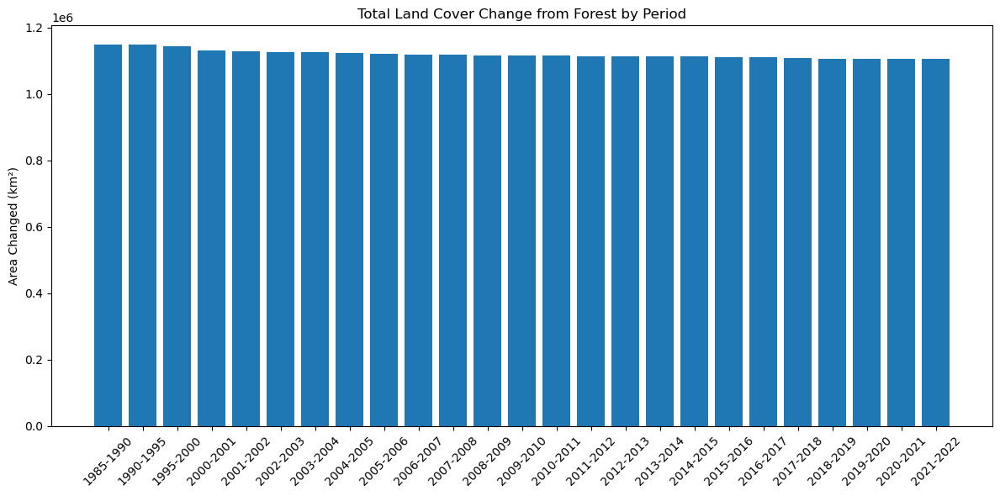

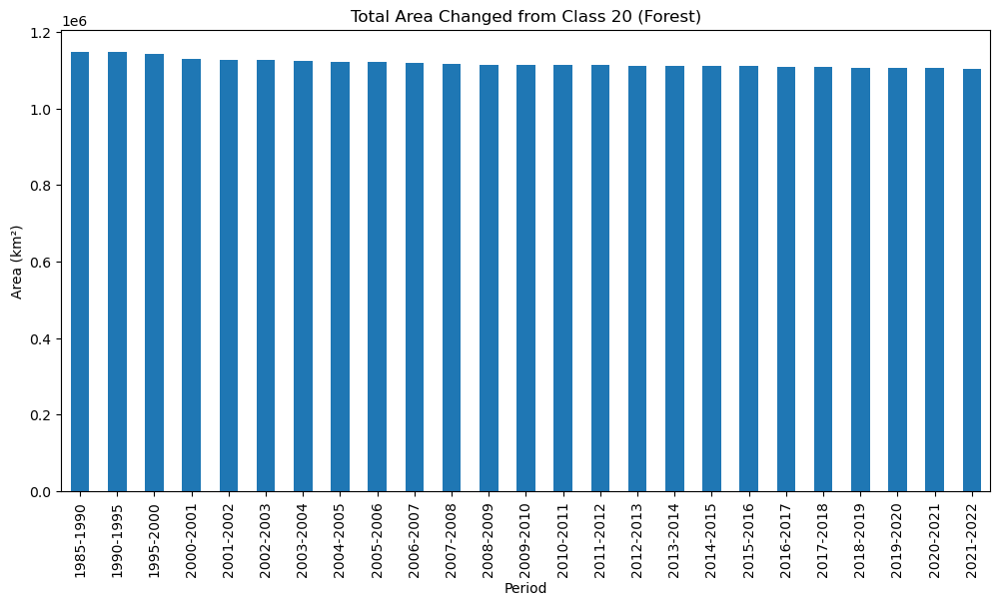

In [12]:
# Compute total area changed from Forest (class 20) per period
period_totals = forest_transitions.groupby('Period')['Area_km2'].sum().reset_index()

# Plot total change over time
plt.figure(figsize=(12, 6))
plt.bar(period_totals['Period'], period_totals['Area_km2'])
plt.title('Total Land Cover Change from Forest by Period')
plt.ylabel('Area Changed (km²)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot net change for specific class
class_of_interest = 20  # Forest
class_changes = full_df.groupby(['Period', 'From'])['Area_km2'].sum().unstack()
class_changes[class_of_interest].plot(
    kind='bar', 
    figsize=(12, 6),
    title=f'Total Area Changed from Class {class_of_interest} (Forest)'
)
plt.ylabel('Area (km²)')
plt.show()





### 🔍 **Persistence of Land Cover Classes**

#### 🧮 **Top Persistent Classes** (No Change Over Time)

Based on total area (`Area_km²`) that didn’t change class across all periods:

| Class | Description (Likely) | Persistent Area (km²) |
| ----- | -------------------- | --------------------- |
| 15    | Water bodies         | 88.34 million         |
| 8     | Cropland             | 42.94 million         |
| 20    | Forest               | 27.61 million         |
| 12    | Bareland             | 27.13 million         |
| 7     | Grassland            | 12.14 million         |
| 5     | Shrubland            | 11.40 million         |
| 13    | Built-up             | 2.53 million          |
| 9     | Wetlands             | 0.95 million          |
| 11    | Snow/Ice             | 0.018 million         |
| 16    | Lichens/Mosses       | 0.10 million          |

✅ **Interpretation**:

* **Water (Class 15)** and **Cropland (Class 8)** exhibit the **highest stability**.
* Forest and Bareland also show strong persistence, hinting at stable biomes or managed lands.
* **Built-up (13)**, while smaller in area, shows increasing persistence—indicative of **irreversible land conversion** (e.g., urbanization).

---

### 📊 **Persistence Over Time (Stacked Bar Chart)**

* Each bar represents a 1–5 year **time interval**.
* The **stacked segments** show the persistent area by class during each period.

#### Key Takeaways:

1. **Relative stability**: The total height of bars (persistent area) is quite consistent across time, suggesting global land cover **doesn’t drastically change** year to year.
2. **Cropland, Forest, and Water dominate**: These three cover types consistently occupy the largest persistent areas.
3. **Urban (Class 13) is growing** slightly in persistence, reflecting infrastructure build-up over time.
4. **No major decline** in persistence is visible for any major class, though minor variability may indicate **regional changes or policy impacts**.




Persistence (no change) by class:


From
15    8.834017e+07
8     4.294144e+07
20    2.760577e+07
12    2.712514e+07
7     1.213583e+07
5     1.140066e+07
13    2.530476e+06
9     9.462416e+05
16    1.012988e+05
11    1.827204e+04
Name: Area_km2, dtype: float64

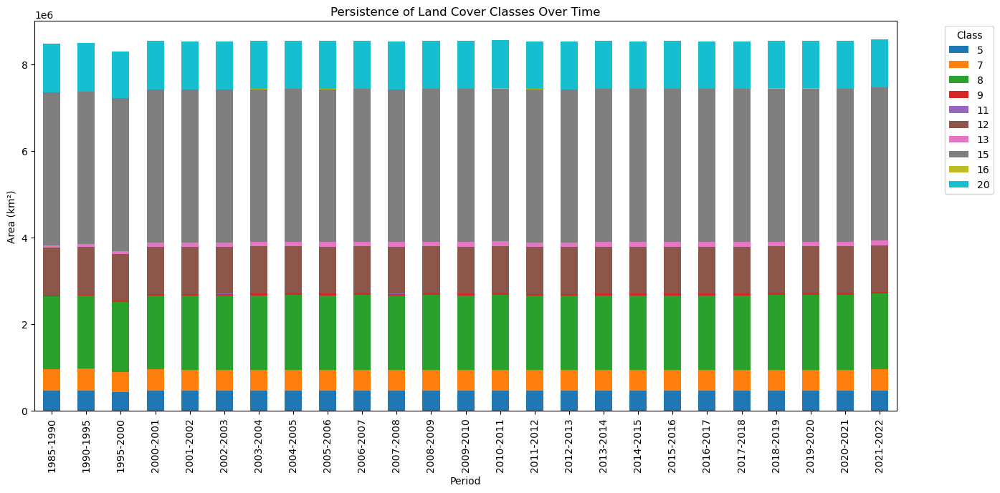

In [13]:
# Calculate persistence (when From == To)
persistence = full_df[full_df['From'] == full_df['To']]
print("\nPersistence (no change) by class:")
persistence_stats = persistence.groupby('From')['Area_km2'].sum().sort_values(ascending=False)
display(persistence_stats)

# Plot persistence over time
persistence.groupby(['Period', 'From'])['Area_km2'].sum().unstack().plot(
    kind='bar', 
    stacked=True,
    figsize=(14, 7),
    title='Persistence of Land Cover Classes Over Time'
)
plt.ylabel('Area (km²)')
plt.legend(title='Class', bbox_to_anchor=(1.05, 1))
plt.tight_layout()
plt.show()



# Transition Probabilities Calculation
In this section, we calculate the transition probabilities from the transition matrix. The transition matrix represents the likelihood of moving from one state (row) to another (column). We normalize the rows of the transition matrix so that each row sums to 1, which allows us to interpret the values as probabilities of transitioning from one state to another.

The code below computes these transition probabilities and displays the resulting matrix.



In [14]:
# Calculate transition probabilities
transition_prob = transition_matrix.div(transition_matrix.sum(axis=1), axis=0)
print("\nTransition probabilities:")
display(transition_prob)



Transition probabilities:


To,5,7,8,9,11,12,13,15,16,20
From,,,,,,,,,,
5,0.969578,0.003195,0.015080,0.001027,1.090097e-04,0.000778,0.001986,0.000098,8.938068e-05,0.008060
7,0.003585,0.970626,0.019164,0.000382,7.364292e-05,0.001605,0.001630,0.000020,4.369681e-06,0.002909
8,0.003830,0.005025,0.982499,0.000527,2.858522e-05,0.000486,0.003532,0.000065,1.195899e-06,0.004005
9,0.009538,0.003556,0.019516,0.888647,5.171562e-05,0.024597,0.002091,0.042173,9.153730e-07,0.009830
11,0.037660,0.028838,0.052894,0.002245,8.526121e-01,0.005855,0.007508,0.001691,2.447522e-04,0.010451
12,0.000342,0.000896,0.001052,0.001392,6.013478e-06,0.995805,0.000324,0.000074,3.858963e-05,0.000070
13,0.006577,0.005622,0.042433,0.000727,6.492881e-05,0.002067,0.937943,0.000200,2.619236e-05,0.004339
15,0.000013,0.000002,0.000021,0.000525,5.799792e-07,0.000028,0.000008,0.999373,1.148586e-05,0.000018
16,0.008064,0.000325,0.000407,0.000008,4.542838e-05,0.009644,0.000722,0.008602,9.693190e-01,0.002864



### Markov Transition Matrix Calculation and Normalization

This section of the code uses `sklearn.preprocessing.normalize` to normalize the transition matrix into a Markov transition matrix. The normalization process ensures that the sum of each row in the transition matrix equals 1, representing the transition probabilities between states.

The key steps involved are:

1. **Normalization**:
   - The `normalize()` function from `sklearn.preprocessing` is used to normalize the transition matrix. This function scales the rows of the matrix such that each row sums to 1, making it suitable for use in Markov processes. 
   - The normalization is performed using the `l1` norm (sum of absolute values), which divides each element of a row by the sum of the elements in that row (`axis=1`).

2. **Markov Transition Matrix**:
   - After normalization, the resulting matrix is called the **Markov transition matrix**. It represents the probabilities of transitioning from one state to another, with each row summing to 1.

3. **Display the Results**:
   - The normalized Markov transition matrix is displayed using `pd.DataFrame` for better readability. The rows and columns represent the "From" and "To" states, respectively.



In this matrix:

* Each row sums to 1, indicating that the values represent transition probabilities.





In [15]:
from sklearn.preprocessing import normalize

# Normalize the transition matrix
markov_matrix = normalize(transition_matrix, norm='l1', axis=1)
print("\nMarkov transition matrix:")
display(pd.DataFrame(markov_matrix, 
                    index=transition_matrix.index, 
                    columns=transition_matrix.columns))


Markov transition matrix:


To,5,7,8,9,11,12,13,15,16,20
From,,,,,,,,,,
5,0.969578,0.003195,0.015080,0.001027,1.090097e-04,0.000778,0.001986,0.000098,8.938068e-05,0.008060
7,0.003585,0.970626,0.019164,0.000382,7.364292e-05,0.001605,0.001630,0.000020,4.369681e-06,0.002909
8,0.003830,0.005025,0.982499,0.000527,2.858522e-05,0.000486,0.003532,0.000065,1.195899e-06,0.004005
9,0.009538,0.003556,0.019516,0.888647,5.171562e-05,0.024597,0.002091,0.042173,9.153730e-07,0.009830
11,0.037660,0.028838,0.052894,0.002245,8.526121e-01,0.005855,0.007508,0.001691,2.447522e-04,0.010451
12,0.000342,0.000896,0.001052,0.001392,6.013478e-06,0.995805,0.000324,0.000074,3.858963e-05,0.000070
13,0.006577,0.005622,0.042433,0.000727,6.492881e-05,0.002067,0.937943,0.000200,2.619236e-05,0.004339
15,0.000013,0.000002,0.000021,0.000525,5.799792e-07,0.000028,0.000008,0.999373,1.148586e-05,0.000018
16,0.008064,0.000325,0.000407,0.000008,4.542838e-05,0.009644,0.000722,0.008602,9.693190e-01,0.002864


In [16]:
# Identify most dynamic classes
class_activity = full_df.groupby('From')['Area_km2'].sum().sort_values(ascending=False)
print("\nMost dynamic classes:")
display(class_activity)

# Identify stable classes
stable_classes = persistence_stats[persistence_stats > 1e6]  # Adjust threshold as needed
print("\nMost stable classes:")
display(stable_classes)



Most dynamic classes:


From
15    8.839558e+07
8     4.370635e+07
20    2.798175e+07
12    2.723941e+07
7     1.250309e+07
5     1.175838e+07
13    2.697901e+06
9     1.064812e+06
16    1.045051e+05
11    2.143065e+04
Name: Area_km2, dtype: float64


Most stable classes:


From
15    8.834017e+07
8     4.294144e+07
20    2.760577e+07
12    2.712514e+07
7     1.213583e+07
5     1.140066e+07
13    2.530476e+06
Name: Area_km2, dtype: float64

In [20]:
import pandas as pd
import plotly.graph_objects as go
import numpy as np
import colorsys

# Load and prepare data
df = pd.read_csv('/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv')

# Define class labels and colors
class_labels = {
    5: 'Shrubland', 7: 'Grassland', 8: 'Cropland', 9: 'Wetland',
    11: 'Lichens/Mosses', 12: 'Bareland', 13: 'Built-up', 15: 'Water',
    16: 'Ice/Snow', 20: 'Forest', 255: 'No Data'
}

class_colors = {
    'Shrubland': '#8C564B', 
    'Grassland': '#FF7F0E', 
    'Cropland': '#D62728',
    'Wetland': '#1F77B4', 
    'Lichens/Mosses': '#9467BD', 
    'Bareland': '#7F7F7F',
    'Built-up': '#BCBD22', 
    'Water': '#17BECF', 
    'Ice/Snow': '#AEC7E8',
    'Forest': '#2CA02C', 
    'No Data': '#CCCCCC'
}

# Function to lighten hex colors
def lighten_hex_color(hex_color, factor=0.2):
    hex_color = hex_color.lstrip('#')
    r, g, b = tuple(int(hex_color[i:i+2], 16) for i in (0, 2, 4))
    h, l, s = colorsys.rgb_to_hls(r/255, g/255, b/255)
    l = min(1.0, l + factor)
    r, g, b = colorsys.hls_to_rgb(h, l, s)
    return '#%02x%02x%02x' % (int(r*255), int(g*255), int(b*255))

# Create transition matrix
classes = sorted(df['From'].unique())
n_classes = len(classes)
transition_matrix = np.zeros((n_classes, n_classes))

for _, row in df.iterrows():
    from_idx = classes.index(row['From'])
    to_idx = classes.index(row['To'])
    transition_matrix[from_idx, to_idx] += row['Area_km2']

# Normalize for visualization
max_value = transition_matrix.max()
normalized_matrix = transition_matrix / max_value * 100

# Create figure
fig = go.Figure()

# Add nodes first
for i, class_id in enumerate(classes):
    label = class_labels[class_id]
    fig.add_trace(go.Scatter(
        x=[0], y=[0],
        mode='markers+text',
        marker=dict(
            size=transition_matrix[i,:].sum()/5000 + 20,
            color=class_colors[label],
            line=dict(width=2, color='white')
        ),
        text=[label],
        hoverinfo='text',
        hovertext=(
            f"<b>{label}</b><br>"
            f"<b>Total Outflow:</b> {transition_matrix[i,:].sum():,.0f} km²<br>"
            f"<b>Total Inflow:</b> {transition_matrix[:,i].sum():,.0f} km²"
        ),
        textfont=dict(size=12, color=class_colors[label]),
        showlegend=False
    ))

# Create circular layout
theta = np.linspace(0, 2*np.pi, n_classes, endpoint=False)
radius = 1.5
node_x = radius * np.cos(theta)
node_y = radius * np.sin(theta)

# Position nodes
for i in range(n_classes):
    fig.data[i].x = [node_x[i]]
    fig.data[i].y = [node_y[i]]
    fig.data[i].textposition = 'middle right' if node_x[i] > 0 else 'middle left'

# Add chords (connections)
for i in range(n_classes):
    for j in range(n_classes):
        if transition_matrix[i,j] > 0:
            t = np.linspace(0, 1, 50)
            x = (1-t)**3 * node_x[i] + 3*(1-t)**2*t*(node_x[i]*0.7) + 3*(1-t)*t**2*(node_x[j]*0.7) + t**3*node_x[j]
            y = (1-t)**3 * node_y[i] + 3*(1-t)**2*t*(node_y[i]*0.7) + 3*(1-t)*t**2*(node_y[j]*0.7) + t**3*node_y[j]
            
            chord_color = lighten_hex_color(class_colors[class_labels[classes[i]]])
            
            fig.add_trace(go.Scatter(
                x=x,
                y=y,
                mode='lines',
                line=dict(
                    width=normalized_matrix[i,j]/3,
                    color=chord_color,
                    smoothing=1.3
                ),
                opacity=0.6,
                hoverinfo='text',
                hovertext=(
                    f"<b>From:</b> {class_labels[classes[i]]}<br>"
                    f"<b>To:</b> {class_labels[classes[j]]}<br>"
                    f"<b>Area:</b> {transition_matrix[i,j]:,.0f} km²<br>"
                    f"<b>Percentage:</b> {normalized_matrix[i,j]:.1f}%"
                ),
                showlegend=False
            ))

# Update layout
fig.update_layout(
    title=dict(
        text="<b>Land Cover Transition Flows</b><br><span style='font-size:14px'>Chord Diagram Visualization</span>",
        x=0.5,
        y=0.95,
        font=dict(size=20, family="Arial")
    ),
    showlegend=False,
    plot_bgcolor='white',
    paper_bgcolor='white',
    width=1000,
    height=900,
    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    margin=dict(t=100, b=50, l=50, r=50),
    hoverlabel=dict(
        bgcolor='white',
        font_size=12,
        font_family="Arial"
    )
)

# Add color legend
for i, (label, color) in enumerate(class_colors.items()):
    fig.add_annotation(
        x=-1.8 if i < len(class_colors)//2 else 1.8,
        y=1.8 - (i % (len(class_colors)//2))*0.2,
        xref="x",
        yref="y",
        text=label,
        showarrow=False,
        font=dict(color=color, size=10),
        align='left' if i >= len(class_colors)//2 else 'right'
    )

# Add data source
fig.add_annotation(
    x=1,
    y=-1.8,
    xref="x",
    yref="y",
    text="Data source: Land Cover Transition Analysis",
    showarrow=False,
    font=dict(size=10, color="gray")
)

fig.show()


# Export as fully interactive HTML (corrected config)
fig.write_html(
    "/Users/ghulamabbaszafari/Desktop/ptof/landcover_transition_chord.html",
    config={
        'responsive': True,
        'scrollZoom': True,
        'displayModeBar': True,
        'displaylogo': False,
        'modeBarButtonsToRemove': ['lasso2d', 'select2d'],
        'toImageButtonOptions': {
            'format': 'png',
            'filename': 'landcover_transition',
            'height': 900,
            'width': 1200,
            'scale': 2
        }
    },
    include_plotlyjs='cdn',
    full_html=True,
    auto_open=False,
    default_width='100%',
    default_height='85vh',
    div_id='landcover-chord-diagram'
)

print(f"Interactive HTML saved to: /Users/ghulamabbaszafari/Desktop/ptof/landcover_transition_chord.html")







Interactive HTML saved to: /Users/ghulamabbaszafari/Desktop/ptof/landcover_transition_chord.html


In [21]:
# Calculate summary statistics
total_outflow = transition_matrix.sum(axis=1)
total_inflow = transition_matrix.sum(axis=0)
mean_transition = np.mean(transition_matrix[transition_matrix > 0])

# Prepare data for bar plot
land_cover_stats = pd.DataFrame({
    'Land Cover': [class_labels[c] for c in classes],
    'Total Outflow (km²)': total_outflow,
    'Total Inflow (km²)': total_inflow,
    'Color': [class_colors[class_labels[c]] for c in classes]
}).sort_values('Total Outflow (km²)', ascending=False)

# Create bar plot
fig = go.Figure()

# Outflow bars
fig.add_trace(go.Bar(
    x=land_cover_stats['Land Cover'],
    y=land_cover_stats['Total Outflow (km²)'],
    name='Outflow',
    marker_color=land_cover_stats['Color'],
    marker_line_color='white',
    marker_line_width=1.5,
    opacity=0.8,
    hoverinfo='y+text',
    hovertext=[f"Outflow: {val:,.0f} km²" for val in land_cover_stats['Total Outflow (km²)']]
))

# Inflow bars
fig.add_trace(go.Bar(
    x=land_cover_stats['Land Cover'],
    y=land_cover_stats['Total Inflow (km²)'],
    name='Inflow',
    marker_color=[lighten_hex_color(c) for c in land_cover_stats['Color']],
    marker_line_color='white',
    marker_line_width=1.5,
    opacity=0.6,
    hoverinfo='y+text',
    hovertext=[f"Inflow: {val:,.0f} km²" for val in land_cover_stats['Total Inflow (km²)']]
))

# Update layout
fig.update_layout(
    title=dict(
        text="<b>Land Cover Transition Statistics</b>",
        x=0.5,
        font=dict(size=20, family="Arial")
    ),
    xaxis=dict(
        title='Land Cover Type',
        tickangle=45,
        tickfont=dict(size=10)
    ),
    yaxis=dict(
        title='Area (km²)',
        tickformat=',.0f'
    ),
    plot_bgcolor='white',
    paper_bgcolor='white',
    width=1000,
    height=600,
    margin=dict(t=100, b=150, l=50, r=50),
    hoverlabel=dict(
        bgcolor='white',
        font_size=12,
        font_family="Arial"
    ),
    barmode='group',
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    )
)

# Add mean annotation
fig.add_annotation(
    x=0.5,
    y=1.1,
    xref="paper",
    yref="paper",
    text=f"Mean Transition Area: {mean_transition:,.0f} km²",
    showarrow=False,
    font=dict(size=12, color="gray")
)

fig.show()




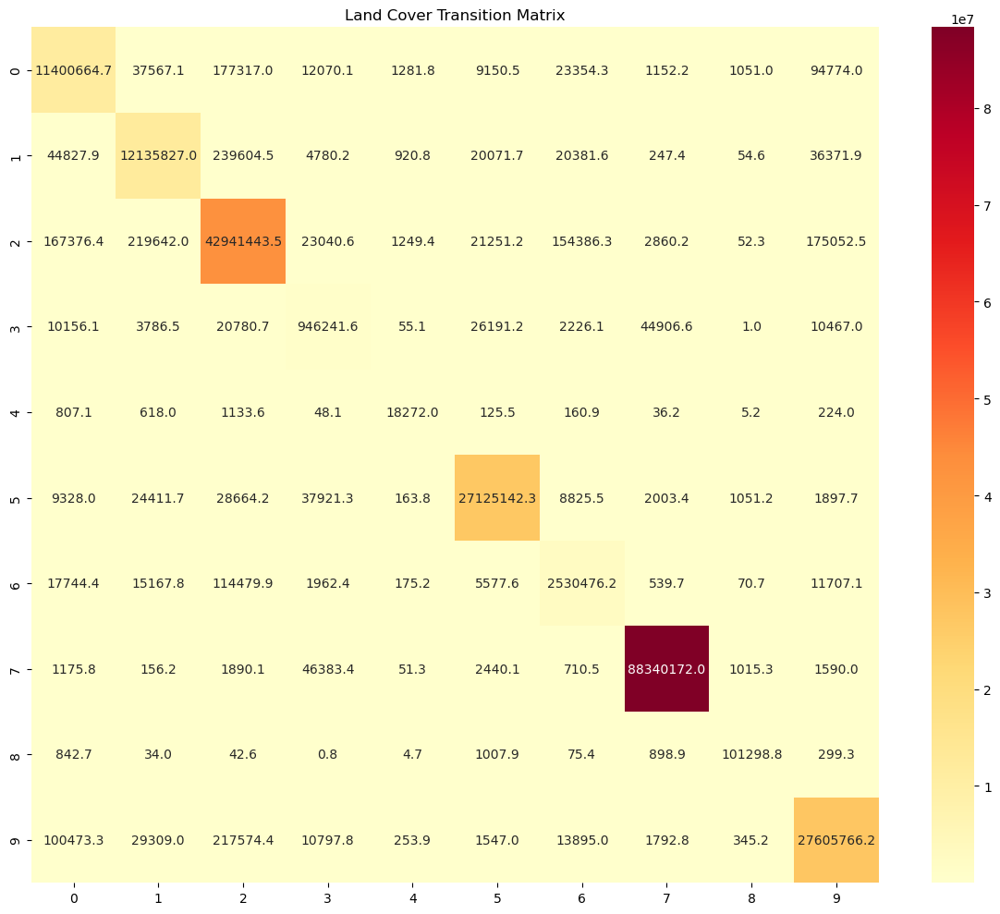

In [22]:
import seaborn as sns

plt.figure(figsize=(12, 10))
sns.heatmap(transition_matrix, cmap="YlOrRd", annot=True, fmt=".1f")
plt.title('Land Cover Transition Matrix')
plt.tight_layout()
plt.show()



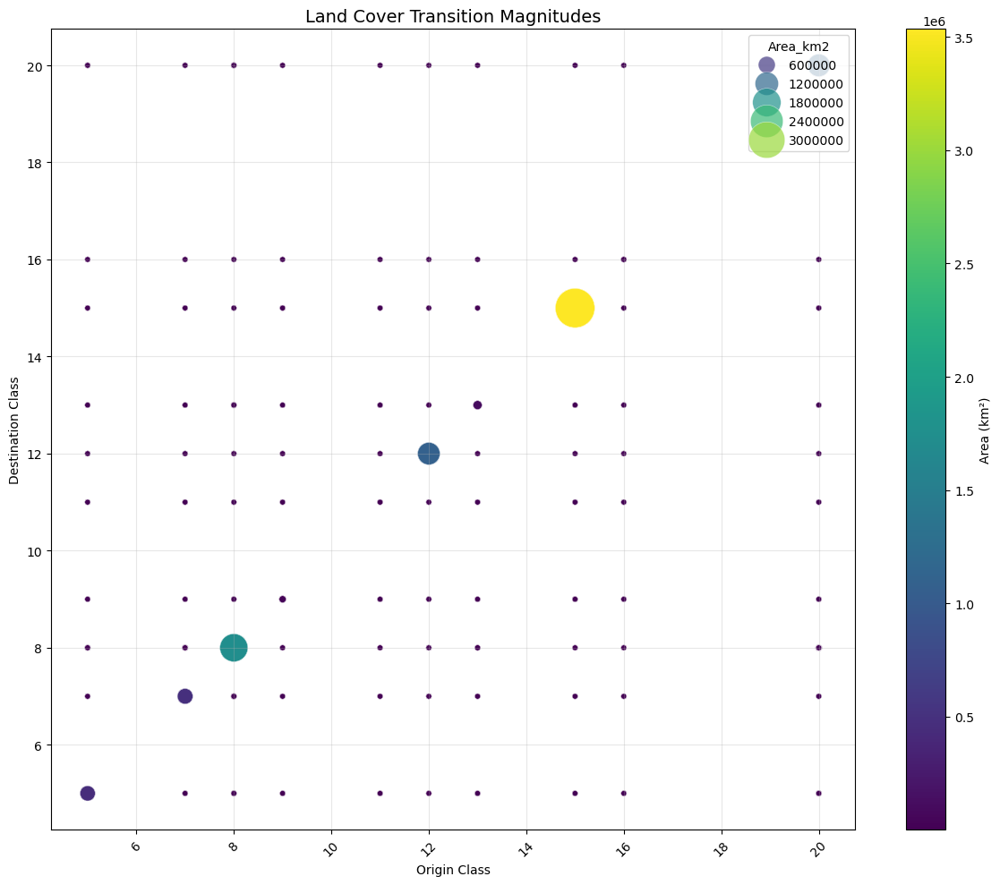

In [23]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load your data
full_df = pd.read_csv('/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv')

# Create scatter plot
plt.figure(figsize=(12,10))
scatter = sns.scatterplot(
    data=full_df,
    x='From',
    y='To',
    size='Area_km2',
    hue='Area_km2',
    sizes=(20, 1000),
    palette='viridis',
    alpha=0.7,
    legend='brief'
)

# Titles and labels
plt.title("Land Cover Transition Magnitudes", fontsize=14)
plt.xlabel("Origin Class")
plt.ylabel("Destination Class")
plt.xticks(rotation=45)
plt.grid(True, alpha=0.3)

# Fix legend (colorbar-like effect)
norm = plt.Normalize(full_df['Area_km2'].min(), full_df['Area_km2'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=plt.gca())
cbar.set_label('Area (km²)')

plt.tight_layout()
plt.show()




In [24]:
import pandas as pd
import plotly.express as px

# Load data
full_df = pd.read_csv('/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv')

# Land cover class labels and colors
class_labels = {
    5: 'Shrubland', 7: 'Grassland', 8: 'Cropland', 9: 'Wetland',
    11: 'Lichens and Mosses', 12: 'Bareland', 13: 'Built-up', 15: 'Water',
    16: 'Ice & Snow', 20: 'Forest', 255: 'No Data'
}

class_colors = {
    'Shrubland': '#a65628',
    'Grassland': '#ff7f00',
    'Cropland': '#e41a1c',
    'Wetland': '#377eb8',
    'Lichens and Mosses': '#984ea3',
    'Bareland': '#999999',
    'Built-up': '#dede00',
    'Water': '#1f78b4',
    'Ice & Snow': '#a6cee3',
    'Forest': '#4daf4a',
    'No Data': '#cccccc'
}

# Summarize transitions
alluvial_df = full_df.groupby(['Period', 'From', 'To'])['Area_km2'].sum().reset_index()

# Map class labels to names
alluvial_df['From_Label'] = alluvial_df['From'].map(class_labels)
alluvial_df['To_Label'] = alluvial_df['To'].map(class_labels)

# Create a numeric ID for each class for color mapping
class_ids = {label: i for i, label in enumerate(class_labels.values())}
alluvial_df['Class_ID'] = alluvial_df['From_Label'].map(class_ids)

# Create custom color scale matching our class colors
color_scale = [[i/(len(class_colors)-1), color] for i, color in enumerate(class_colors.values())]

# Plot with correct color mapping
fig = px.parallel_categories(
    alluvial_df,
    dimensions=['From_Label', 'To_Label'],
    color='Class_ID',
    color_continuous_scale=color_scale,
    labels={'From_Label': 'Origin Class', 'To_Label': 'Destination Class'},
    width=1200,
    height=700,
    title="Land Cover Change Transitions"
)

# Update layout and colorbar
fig.update_layout(
    coloraxis_colorbar=dict(
        title='Land Cover Class',
        tickvals=list(range(len(class_colors))),
        ticktext=list(class_colors.keys())
    ),
    hovermode='closest',
    margin=dict(l=80, r=80, t=80, b=80)
)

# Only update the shape parameter
fig.update_traces(
    line_shape='hspline',  # Makes the connections curved
    arrangement='freeform'  # Allows categories to move freely
)

# Show plot
fig.show()




In [25]:
import pandas as pd
import plotly.express as px
import plotly.io as pio

# Load data
full_df = pd.read_csv('/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv')

# Land cover class labels and colors
class_labels = {
    5: 'Shrubland', 7: 'Grassland', 8: 'Cropland', 9: 'Wetland',
    11: 'Lichens and Mosses', 12: 'Bareland', 13: 'Built-up', 15: 'Water',
    16: 'Ice & Snow', 20: 'Forest', 255: 'No Data'
}

class_colors = {
    'Shrubland': '#a65628',
    'Grassland': '#ff7f00',
    'Cropland': '#e41a1c',
    'Wetland': '#377eb8',
    'Lichens and Mosses': '#984ea3',
    'Bareland': '#999999',
    'Built-up': '#dede00',
    'Water': '#1f78b4',
    'Ice & Snow': '#a6cee3',
    'Forest': '#4daf4a',
    'No Data': '#cccccc'
}

# Summarize transitions
alluvial_df = full_df.groupby(['Period', 'From', 'To'])['Area_km2'].sum().reset_index()

# Map class labels to names
alluvial_df['From_Label'] = alluvial_df['From'].map(class_labels)
alluvial_df['To_Label'] = alluvial_df['To'].map(class_labels)

# Create a numeric ID for each class for color mapping
class_ids = {label: i for i, label in enumerate(class_labels.values())}
alluvial_df['Class_ID'] = alluvial_df['From_Label'].map(class_ids)

# Create custom color scale matching our class colors
color_scale = [[i/(len(class_colors)-1), color] for i, color in enumerate(class_colors.values())]

# Plot with correct color mapping - increased size
fig = px.parallel_categories(
    alluvial_df,
    dimensions=['From_Label', 'To_Label'],
    color='Class_ID',
    color_continuous_scale=color_scale,
    labels={'From_Label': 'Origin Class', 'To_Label': 'Destination Class'},
    width=1600,
    height=1000,
    title="Land Cover Change Transitions"
)

# Update layout and colorbar with larger fonts
fig.update_layout(
    coloraxis_colorbar=dict(
        title='Land Cover Class',
        title_font=dict(size=18),
        tickfont=dict(size=16),
        tickvals=list(range(len(class_colors))),
        ticktext=list(class_colors.keys())
    ),
    hovermode='closest',
    margin=dict(l=100, r=100, t=100, b=100),
    title_font=dict(size=24),
    font=dict(size=14)
)

# Improve the appearance of the flow lines
fig.update_traces(
    line_shape='hspline',
    arrangement='freeform'
)

# Show plot
fig.show()

# High-quality PNG export with Kaleido
output_path = '/Users/ghulamabbaszafari/Desktop/ptof/landcover_transitions_highres.png'
try:
    pio.write_image(
        fig,
        output_path,
        format='png',
        width=2400,
        height=1800,
        scale=4,
        engine='kaleido'
    )
    print(f"✅ High-quality PNG successfully saved to: {output_path}")
except Exception as e:
    print(f"❌ Export failed: {str(e)}")
    print("Showing interactive plot only")

    

✅ High-quality PNG successfully saved to: /Users/ghulamabbaszafari/Desktop/ptof/landcover_transitions_highres.png


In [26]:
# Create a pivot table of transitions
transition_matrix = pd.pivot_table(alluvial_df, 
                                 values='Area_km2', 
                                 index='From_Label', 
                                 columns='To_Label',
                                 aggfunc='sum',
                                 fill_value=0)

# Add total columns
transition_matrix['Total_From'] = transition_matrix.sum(axis=1)
transition_matrix.loc['Total_To'] = transition_matrix.sum(axis=0)

# Display with styling
(transition_matrix
 .style
 .background_gradient(cmap='Blues')
 .format('{:,.0f} km²'))



To_Label,Bareland,Built-up,Cropland,Forest,Grassland,Ice & Snow,Lichens and Mosses,Shrubland,Water,Wetland,Total_From
From_Label,,,,,,,,,,,
Bareland,"27,125,142 km²","8,825 km²","28,664 km²","1,898 km²","24,412 km²","1,051 km²",164 km²,"9,328 km²","2,003 km²","37,921 km²","27,239,409 km²"
Built-up,"5,578 km²","2,530,476 km²","114,480 km²","11,707 km²","15,168 km²",71 km²,175 km²,"17,744 km²",540 km²,"1,962 km²","2,697,901 km²"
Cropland,"21,251 km²","154,386 km²","42,941,443 km²","175,052 km²","219,642 km²",52 km²,"1,249 km²","167,376 km²","2,860 km²","23,041 km²","43,706,354 km²"
Forest,"1,547 km²","13,895 km²","217,574 km²","27,605,766 km²","29,309 km²",345 km²,254 km²,"100,473 km²","1,793 km²","10,798 km²","27,981,754 km²"
Grassland,"20,072 km²","20,382 km²","239,605 km²","36,372 km²","12,135,827 km²",55 km²,921 km²,"44,828 km²",247 km²,"4,780 km²","12,503,088 km²"
Ice & Snow,"1,008 km²",75 km²,43 km²,299 km²,34 km²,"101,299 km²",5 km²,843 km²,899 km²,1 km²,"104,505 km²"
Lichens and Mosses,125 km²,161 km²,"1,134 km²",224 km²,618 km²,5 km²,"18,272 km²",807 km²,36 km²,48 km²,"21,431 km²"
Shrubland,"9,151 km²","23,354 km²","177,317 km²","94,774 km²","37,567 km²","1,051 km²","1,282 km²","11,400,665 km²","1,152 km²","12,070 km²","11,758,383 km²"
Water,"2,440 km²",711 km²,"1,890 km²","1,590 km²",156 km²,"1,015 km²",51 km²,"1,176 km²","88,340,172 km²","46,383 km²","88,395,585 km²"


In [27]:
# Calculate net change for each class
net_change = (alluvial_df.groupby('To_Label')['Area_km2'].sum() - 
              alluvial_df.groupby('From_Label')['Area_km2'].sum())

net_change = net_change.reset_index()
net_change.columns = ['Land_Cover_Class', 'Net_Change_km2']

# Visualize
px.bar(net_change, 
       x='Land_Cover_Class', 
       y='Net_Change_km2',
       title='Net Land Cover Change',
       color='Net_Change_km2',
       color_continuous_scale='RdYlGn')



In [28]:
# Prepare the data - ensure correct ordering
period_df = alluvial_df.groupby(['Period', 'From_Label', 'To_Label'])['Area_km2'].sum().reset_index()

# Define category ordering to prevent shuffling
category_order = [
    'Forest', 'Shrubland', 'Grassland', 'Cropland', 'Wetland',
    'Lichens and Mosses', 'Bareland', 'Built-up', 'Water', 'Ice & Snow', 'No Data'
]

# Create professional plot
fig = px.bar(
    period_df,
    x='To_Label',
    y='Area_km2',
    facet_col='Period',
    color='From_Label',
    category_orders={
        'To_Label': category_order,
        'From_Label': category_order,
        'Period': sorted(period_df['Period'].unique())
    },
    color_discrete_map=class_colors,
    labels={
        'To_Label': 'Destination Land Cover Class',
        'Area_km2': 'Area (km²)',
        'From_Label': 'Origin Class'
    },
    title='<b>Land Cover Transition Analysis</b><br><sup>Area Changes Between Time Periods</sup>',
    width=1400,
    height=800,
    template='plotly_white'
)

# Professional styling updates
fig.update_layout(
    font_family="Arial",
    title_font_size=24,
    title_x=0.5,
    uniformtext_minsize=12,
    uniformtext_mode='hide',
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    legend_title_text='Original Land Cover',
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=-0.3,
        xanchor="center",
        x=0.5
    ),
    margin=dict(t=120, b=120)
)

# Axis formatting
fig.update_xaxes(tickangle=45, tickfont=dict(size=12))
fig.update_yaxes(tickformat=",.0f")

# Facet styling
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.update_annotations(font_size=14)

fig.show()





In [29]:
# Prepare the data - ensure correct ordering
period_df = alluvial_df.groupby(['Period', 'From_Label', 'To_Label'])['Area_km2'].sum().reset_index()

# Define category ordering to prevent shuffling
category_order = [
    'Forest', 'Shrubland', 'Grassland', 'Cropland', 'Wetland',
    'Lichens and Mosses', 'Bareland', 'Built-up', 'Water', 'Ice & Snow', 'No Data'
]

# Create professional plot with proper spacing
fig = px.bar(
    period_df,
    x='To_Label',
    y='Area_km2',
    facet_col='Period',
    color='From_Label',
    category_orders={
        'To_Label': category_order,
        'From_Label': category_order,
        'Period': sorted(period_df['Period'].unique())
    },
    color_discrete_map=class_colors,
    labels={
        'To_Label': 'Destination Land Cover Class',
        'Area_km2': 'Area (km²)',
        'From_Label': 'Origin Class'
    },
    title='<b>Land Cover Transition Analysis</b><br><sup>Area Changes Between Time Periods</sup>',
    width=1800,  # Increased width for more space
    height=900,
    template='plotly_white'
)

# Professional styling with proper facet spacing
fig.update_layout(
    font_family="Arial",
    title_font_size=24,
    title_x=0.5,
    title_y=0.95,
    uniformtext_minsize=12,
    uniformtext_mode='hide',
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    legend_title_text='Original Land Cover',
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=-0.4,  # Adjusted lower
        xanchor="center",
        x=0.5,
        itemwidth=30
    ),
    margin=dict(t=150, b=200, l=80, r=80),
    bargap=0.4,
    bargroupgap=0.1
)

# Set facet spacing by updating individual xaxes
for i, period in enumerate(sorted(period_df['Period'].unique())):
    fig.update_xaxes(
        tickangle=45,
        tickfont=dict(size=12),
        row=1, col=i+1,
        domain=[i/len(period_df['Period'].unique()) + 0.02, (i+1)/len(period_df['Period'].unique()) - 0.02]
    )

# Format y-axis
fig.update_yaxes(
    tickformat=",.0f",
    automargin=True
)

# Adjust facet annotations
fig.for_each_annotation(lambda a: a.update(
    text=a.text.split("=")[-1],
    font=dict(size=14),
    y=1.1
))

fig.show()



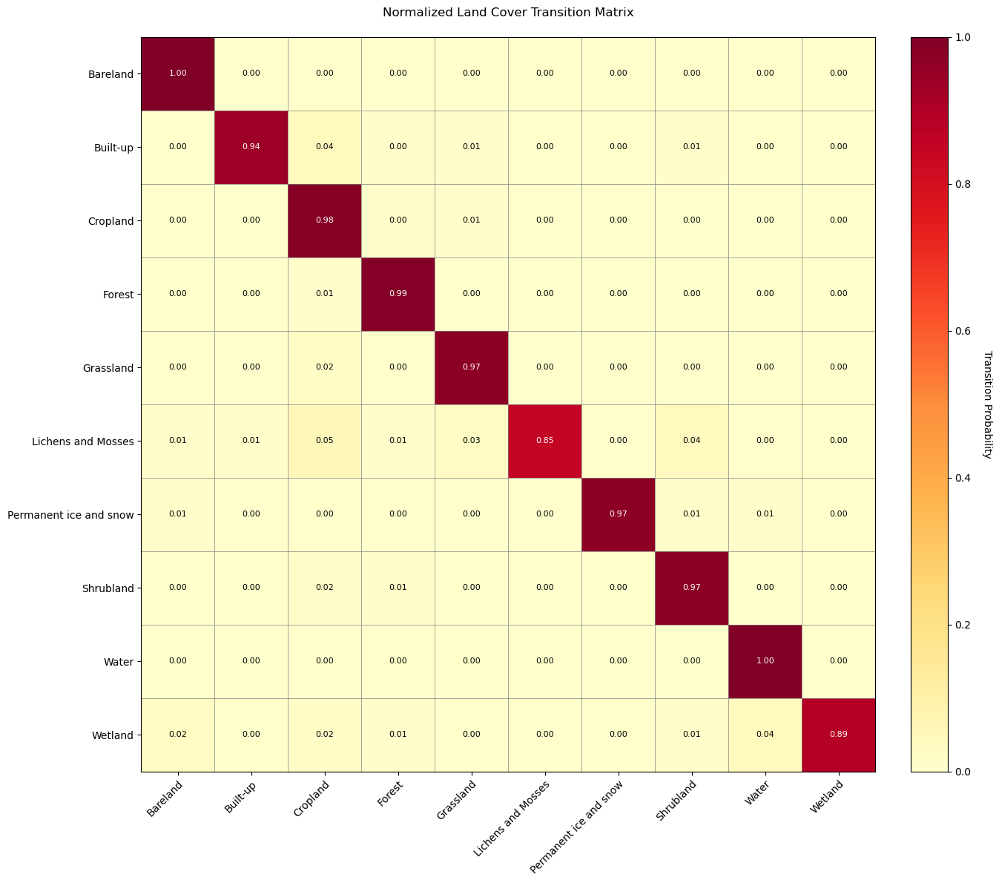

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Load your detailed transitions CSV
df = pd.read_csv("/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv")

# Create full transition matrix
transition_matrix = pd.crosstab(
    index=df['From_Label'],
    columns=df['To_Label'],
    values=df['Area_km2'],
    aggfunc='sum'
).fillna(0)

# Normalize by row (shows % change FROM each class)
normalized_matrix = transition_matrix.div(transition_matrix.sum(axis=1), axis=0)

# Plot heatmap with improved settings
plt.figure(figsize=(14, 12))
ax = plt.gca()

# Create the heatmap
im = ax.imshow(normalized_matrix, cmap='YlOrRd', vmin=0, vmax=1)

# Add colorbar
cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label('Transition Probability', rotation=270, labelpad=20)

# Set ticks and labels
ax.set_xticks(np.arange(len(normalized_matrix.columns)))
ax.set_yticks(np.arange(len(normalized_matrix.index)))
ax.set_xticklabels(normalized_matrix.columns, rotation=45, ha="right", rotation_mode="anchor")
ax.set_yticklabels(normalized_matrix.index)

# Add text annotations in each cell
for i in range(len(normalized_matrix.index)):
    for j in range(len(normalized_matrix.columns)):
        value = normalized_matrix.iloc[i, j]
        if value > 0:  # Only show text for non-zero values
            text_color = "black" if value < 0.5 else "white"  # Auto contrast
            ax.text(j, i, f"{value:.2f}",
                   ha="center", va="center",
                   color=text_color, fontsize=8)

# Add grid lines
ax.set_xticks(np.arange(len(normalized_matrix.columns)+1)-.5, minor=True)
ax.set_yticks(np.arange(len(normalized_matrix.index)+1)-.5, minor=True)
ax.grid(which="minor", color="gray", linestyle='-', linewidth=0.5)
ax.tick_params(which="minor", size=0)

# Add title and adjust layout
plt.title('Normalized Land Cover Transition Matrix', pad=20)
plt.tight_layout()

# Save and show
plt.savefig('transition_heatmap.png', dpi=300, bbox_inches='tight')
plt.show()




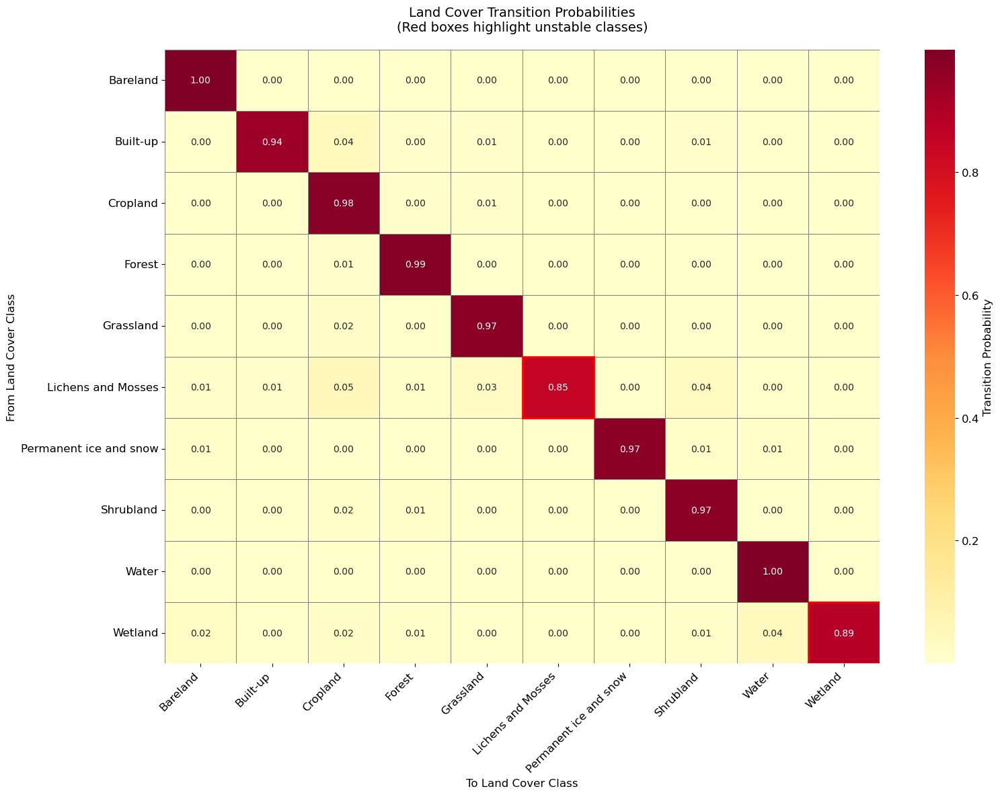

In [31]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # For better heatmaps

# Load data
df = pd.read_csv("/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv")

# Clean labels (fix typos like "Lichene and Mosses" → "Lichens and Mosses")
df['From_Label'] = df['From_Label'].str.replace("Lichene", "Lichens")
df['To_Label'] = df['To_Label'].str.replace("Lichene", "Lichens")

# Create transition matrix
transition_matrix = pd.crosstab(
    index=df['From_Label'],
    columns=df['To_Label'],
    values=df['Area_km2'],
    aggfunc='sum'
).fillna(0)

# Normalize by row (probabilities)
normalized_matrix = transition_matrix.div(transition_matrix.sum(axis=1), axis=0)

# --- Improved Visualization ---
plt.figure(figsize=(16, 12))
plt.rcParams.update({'font.size': 12})

# Custom colormap (yellow → red)
cmap = sns.color_palette("YlOrRd", as_cmap=True)

# Plot heatmap with clustering to group similar transitions
ax = sns.heatmap(
    normalized_matrix,
    cmap=cmap,
    annot=True,  # Show values
    fmt=".2f",   # 2 decimal places
    annot_kws={"size": 10},
    linewidths=0.5,
    linecolor="gray",
    cbar_kws={"label": "Transition Probability"}
)

# Highlight unstable classes (diagonal < 0.9)
for i, label in enumerate(normalized_matrix.index):
    prob = normalized_matrix.iloc[i, i]
    if prob < 0.9:
        ax.add_patch(plt.Rectangle((i, i), 1, 1, fill=False, edgecolor='red', lw=2))

# Rotate labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)

# Titles and adjustments
plt.title("Land Cover Transition Probabilities\n(Red boxes highlight unstable classes)", pad=20, fontsize=14)
plt.xlabel("To Land Cover Class")
plt.ylabel("From Land Cover Class")
plt.tight_layout()

# Save high-res version
plt.savefig('transition_heatmap_improved.png', dpi=300, bbox_inches='tight')
plt.show()



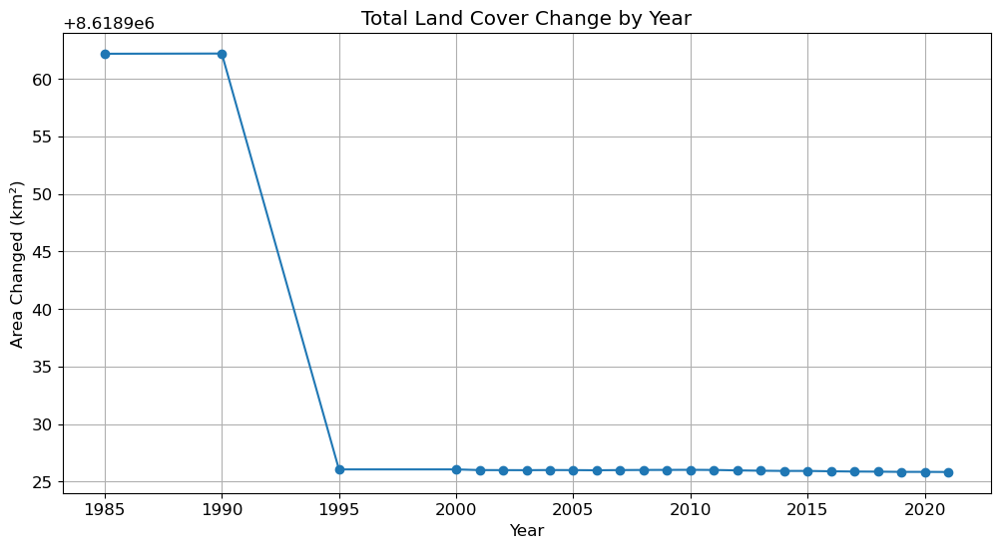

In [32]:
# Annual change analysis
annual_change = df.groupby('Period')['Area_km2'].sum().reset_index()
annual_change['Year'] = annual_change['Period'].str[:4].astype(int)

# Plot change over time
plt.figure(figsize=(12,6))
plt.plot(annual_change['Year'], annual_change['Area_km2'], marker='o')
plt.title('Total Land Cover Change by Year')
plt.xlabel('Year')
plt.ylabel('Area Changed (km²)')
plt.grid(True)
plt.savefig('annual_change.png', dpi=300)


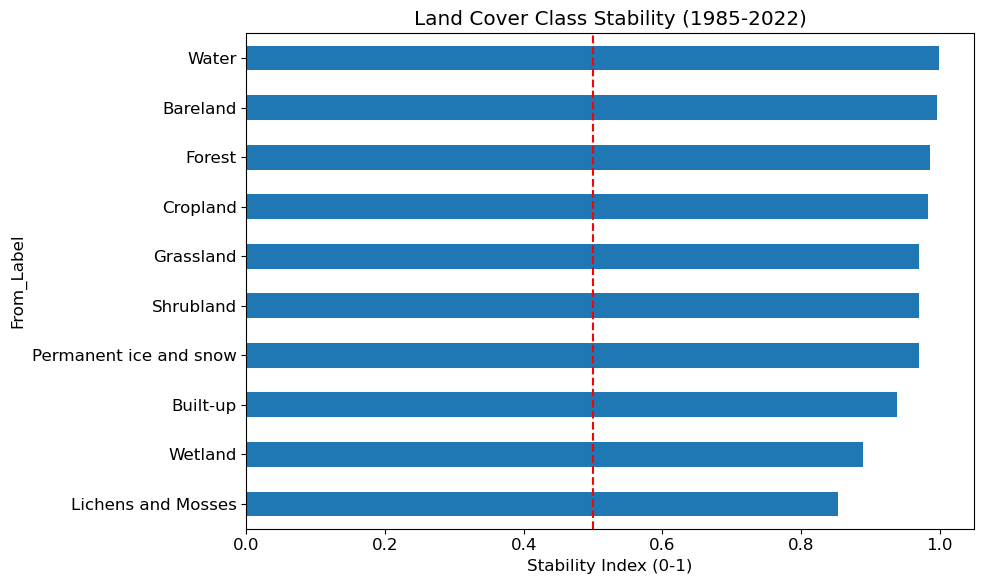

In [37]:
# Calculate persistence (same FROM and TO)
persistence = df[df['From'] == df['To']].groupby('From_Label')['Area_km2'].sum()
change = df[df['From'] != df['To']].groupby('From_Label')['Area_km2'].sum()

stability = (persistence / (persistence + change)).sort_values()

# Plot stability index
stability.plot(kind='barh', figsize=(10,6))
plt.title('Land Cover Class Stability (1985-2022)')
plt.xlabel('Stability Index (0-1)')
plt.axvline(0.5, color='red', linestyle='--')
plt.tight_layout()
plt.savefig('stability_index.png', dpi=300)



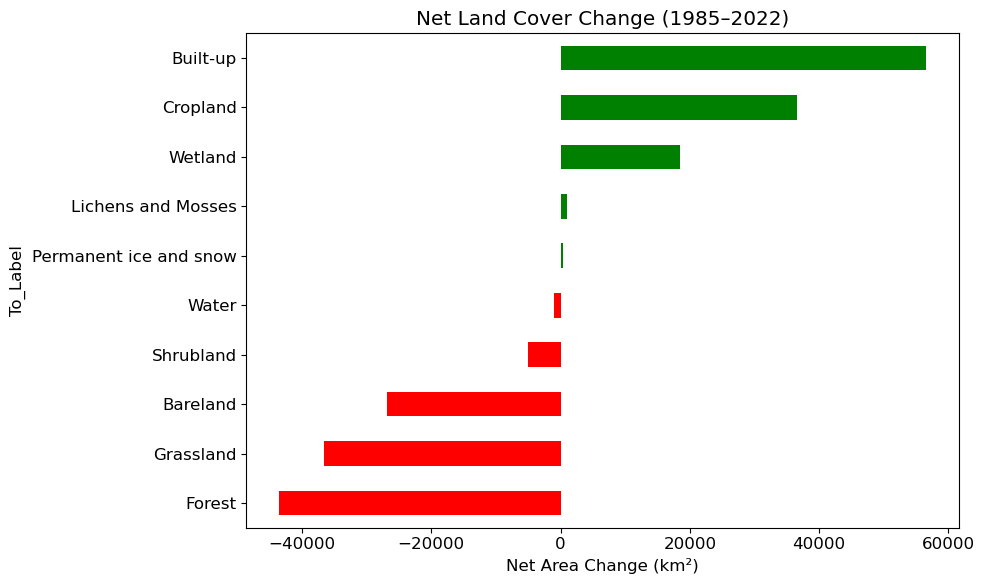

In [34]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load your data
df = pd.read_csv('/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv')

# Calculate net change for each class
net_change = df.groupby('To_Label')['Area_km2'].sum() - df.groupby('From_Label')['Area_km2'].sum()
net_change = net_change.sort_values()

# Plot net change
plt.figure(figsize=(10,6))
net_change.plot(kind='barh', color=np.where(net_change > 0, 'g', 'r'))
plt.title('Net Land Cover Change (1985–2022)')
plt.xlabel('Net Area Change (km²)')
plt.tight_layout()
plt.savefig('net_change.png', dpi=300)
plt.show()


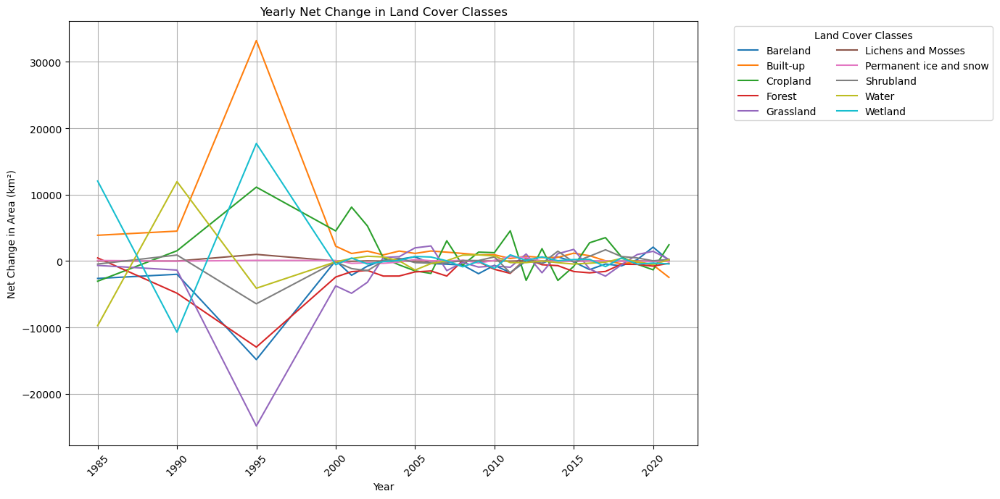

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import defaultdict

# Load the CSV file
file_path = "/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv"
df = pd.read_csv(file_path)

# Drop rows with missing labels or period
df = df.dropna(subset=['From_Label', 'To_Label', 'Area_km2', 'Period'])

# Prepare the dictionary for yearly changes
yearly_changes = defaultdict(lambda: defaultdict(float))

# Loop through each row to populate yearly_changes
for _, row in df.iterrows():
    period = row['Period']
    try:
        year = int(str(period).split("-")[0])  # Extract the 'from' year
    except:
        continue  # Skip rows with invalid year

    from_label = row['From_Label']
    to_label = row['To_Label']
    area = row['Area_km2']

    # Subtract area from the "from" class
    yearly_changes[year][from_label] -= area

    # Add area to the "to" class
    yearly_changes[year][to_label] += area

# Now define the plotting function
def plot_yearly_changes(yearly_changes):
    plt.figure(figsize=(14, 7))

    # Extract unique land cover classes from all years
    all_classes = set()
    for year_dict in yearly_changes.values():
        all_classes.update(year_dict.keys())
    all_classes = sorted(all_classes)

    years = sorted(yearly_changes.keys())

    # Plot each class
    for land_cover_class in all_classes:
        changes = [yearly_changes[year].get(land_cover_class, 0) for year in years]
        plt.plot(years, changes, label=land_cover_class)

    plt.xlabel('Year')
    plt.ylabel('Net Change in Area (km²)')
    plt.title('Yearly Net Change in Land Cover Classes')
    plt.legend(title="Land Cover Classes", bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2)
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Call the function
plot_yearly_changes(yearly_changes)


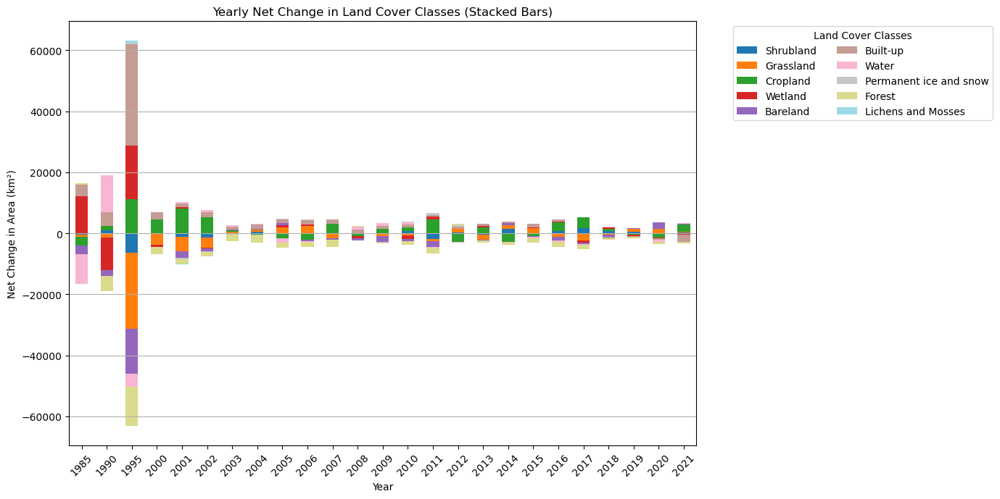

In [3]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_yearly_changes_bars(yearly_changes):
    # Convert yearly_changes dictionary to DataFrame
    df_changes = pd.DataFrame(yearly_changes).T.fillna(0).sort_index()

    # Plot as stacked bar chart
    ax = df_changes.plot(kind='bar', stacked=True, figsize=(14, 7), colormap='tab20')

    plt.xlabel('Year')
    plt.ylabel('Net Change in Area (km²)')
    plt.title('Yearly Net Change in Land Cover Classes (Stacked Bars)')
    plt.legend(title='Land Cover Classes', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2)
    plt.xticks(rotation=45)
    plt.grid(True, axis='y')
    plt.tight_layout()
    plt.show()

# Call the function (assuming `yearly_changes` is already built as shown earlier)
plot_yearly_changes_bars(yearly_changes)


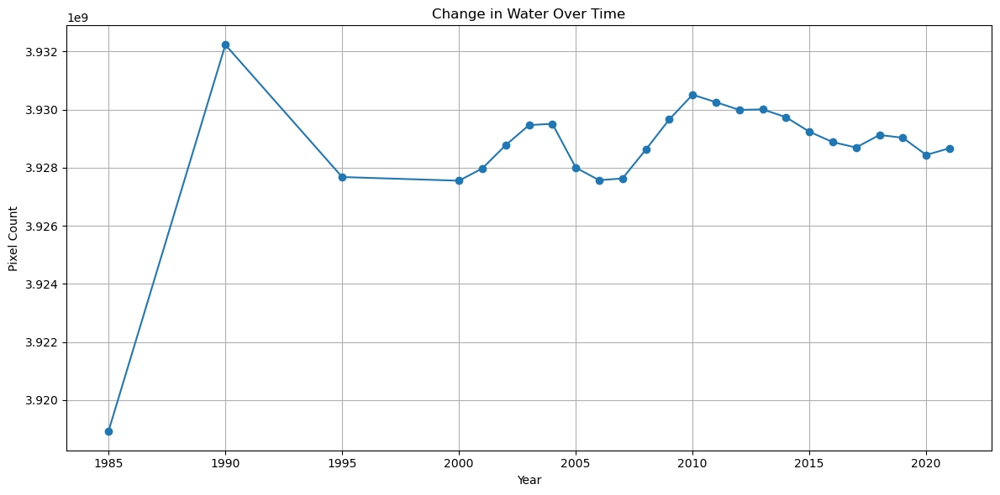

In [9]:
import pandas as pd
import matplotlib.pyplot as plt

# --- Class labels dictionary
CLASS_LABELS = {
    5: "Shrubland",
    7: "Grassland",
    8: "Cropland",
    9: "Wetland",
    11: "Lichens and Mosses",
    12: "Bareland",
    13: "Built-up",
    15: "Water",
    16: "Permanent ice and snow",
    20: "Forest"
}

# Load your file
file_path = "/Users/ghulamabbaszafari/Desktop/GLC_/landcover_1transitions_detailed_20250514_0856.csv"
df_raw = pd.read_csv(file_path)

# --- Clean data
df_raw.dropna(subset=['From', 'To', 'Period', 'Count'], inplace=True)
df_raw['From'] = df_raw['From'].astype(int)
df_raw['To'] = df_raw['To'].astype(int)

# --- Extract the starting year from Period (e.g., '1985-1990' → 1985, '2002' → 2002)
df_raw['Year'] = df_raw['Period'].astype(str).str.extract(r"(\d{4})").astype(int)

# --- Build the land_cover_trends dictionary: {year: {to_class: count}}
land_cover_trends = {}
for _, row in df_raw.iterrows():
    year = row['Year']
    to_class = row['To']
    count = row['Count']
    
    if year not in land_cover_trends:
        land_cover_trends[year] = {}
    if to_class not in land_cover_trends[year]:
        land_cover_trends[year][to_class] = 0
    
    land_cover_trends[year][to_class] += count

# --- Convert to DataFrame
df = pd.DataFrame.from_dict(land_cover_trends, orient="index").sort_index()

# --- Plot a specific class (change 15 to any available class in CLASS_LABELS)
land_cover_class = 15  # e.g., 15 = Water
if land_cover_class in df.columns:
    label = CLASS_LABELS.get(land_cover_class, f"Class {land_cover_class}")
    df[land_cover_class].plot(kind="line", figsize=(12, 6), marker="o", title=f"Change in {label} Over Time")
    plt.xlabel("Year")
    plt.ylabel("Pixel Count")
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print(f"Class {land_cover_class} not found in the data.")


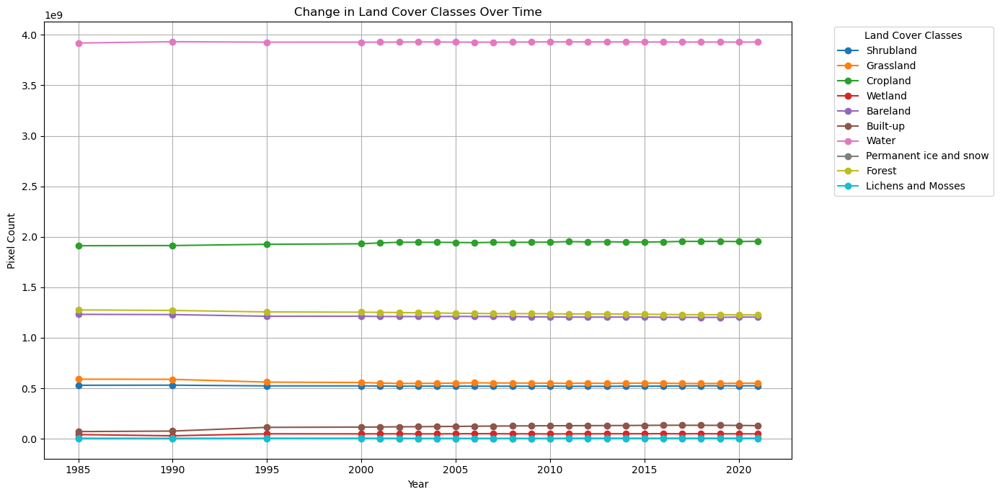

In [10]:
import matplotlib.pyplot as plt

# Plot all land cover classes over time (line chart)
def plot_all_classes_line(df, class_labels):
    plt.figure(figsize=(14, 7))
    
    for col in df.columns:
        label = class_labels.get(col, f"Class {col}")
        plt.plot(df.index, df[col], marker='o', label=label)

    plt.xlabel("Year")
    plt.ylabel("Pixel Count")
    plt.title("Change in Land Cover Classes Over Time")
    plt.legend(title="Land Cover Classes", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Call the function
plot_all_classes_line(df, CLASS_LABELS)


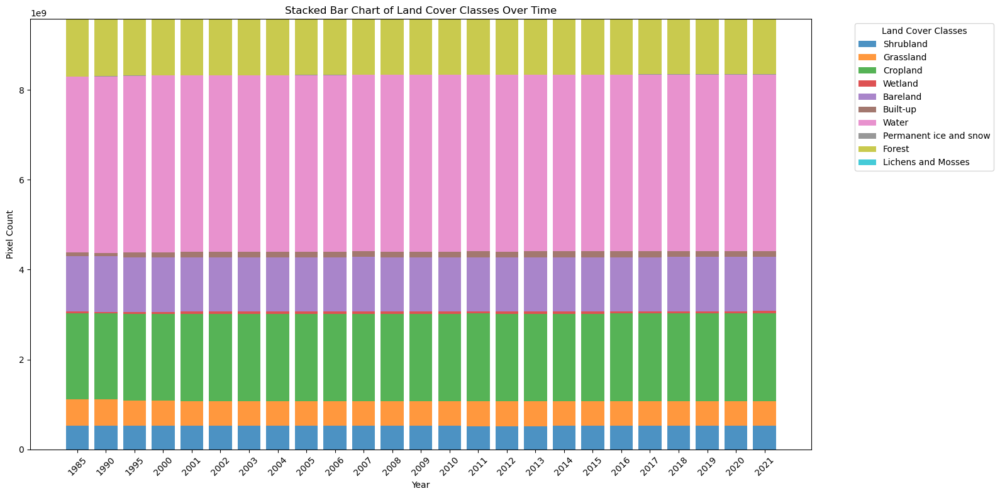

In [11]:
import numpy as np

# Plot all land cover classes as stacked bars by year
def plot_all_classes_bars(df, class_labels):
    df_sorted = df.sort_index()
    years = df_sorted.index.astype(str)
    bottom = np.zeros(len(years))

    plt.figure(figsize=(16, 8))

    for col in df_sorted.columns:
        label = class_labels.get(col, f"Class {col}")
        plt.bar(years, df_sorted[col], bottom=bottom, label=label, alpha=0.8)
        bottom += df_sorted[col].fillna(0)

    plt.xlabel("Year")
    plt.ylabel("Pixel Count")
    plt.title("Stacked Bar Chart of Land Cover Classes Over Time")
    plt.legend(title="Land Cover Classes", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Call the function
plot_all_classes_bars(df, CLASS_LABELS)


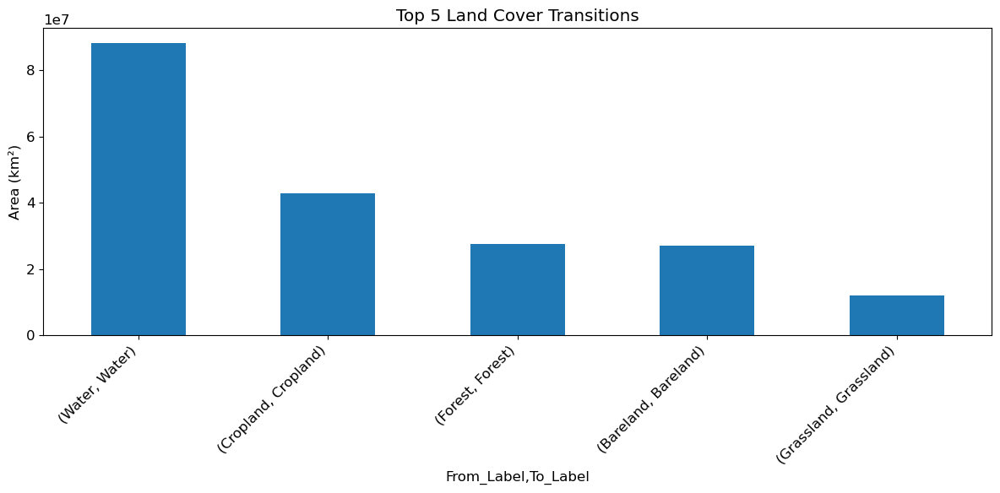

In [39]:
# Get top 5 most significant transitions
top_transitions = df.groupby(['From_Label', 'To_Label'])['Area_km2'].sum().nlargest(5)

# Plot
top_transitions.plot(kind='bar', figsize=(12,6))
plt.title('Top 5 Land Cover Transitions')
plt.ylabel('Area (km²)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig('top_transitions.png', dpi=300)

In [ ]:
import grass.script as gs
from IPython.display import Image
import os

# Step 1: Define the test raster
test_raster = 'trans_map_1985_1990'

# Step 2: Check if the test raster exists
available_rasters = gs.read_command(
    'g.list',
    type='raster',
    pattern=test_raster
).strip().splitlines()

if test_raster not in available_rasters:
    raise ValueError(f"Test raster '{test_raster}' not found in the current GRASS mapset.")

print(f"✅ Found test raster: {test_raster}")

# Step 3: Run r.series on just the test raster (trivial count of 1 where non-null)
gs.run_command(
    'r.series',
    input=test_raster,
    output='change_frequency_test',
    method='count',
    overwrite=True
)

# Step 4: Reclassify result (effectively checking logic works)
reclass_rules = """
0 thru 0 = 0 NoData
1 thru 1 = 1 Changed
"""

gs.write_command(
    'r.reclass',
    input='change_frequency_test',
    output='change_hotspots_test',
    rules='-',
    stdin=reclass_rules,
    overwrite=True
)

# Step 5: Optional color and export to PNG
gs.run_command('r.colors', map='change_hotspots_test', color='gyr')

gs.run_command(
    'r.out.png',
    input='change_hotspots_test',
    output='change_hotspots_test.png',
    overwrite=True
)

# Step 6: Display test result
Image(filename='change_hotspots_test.png')


✅ Found test raster: trans_map_1985_1990



Color table for raster map <change_hotspots_test> set to 'gyr'
